# Foraging toolkit demo on simulated agents of three types (Random, Hungry, and Follower)
This notebook uses the foraging toolkit to simulate three types of agents, and infers their preferences from their movement trajectories. 

Users of the foraging toolkit are interested in analyzing animal movement data, with the goal of determining what factors contribute to each agent's decisions of where to move. 

In this demo on simulated data, we consider two possible factors that may influence agents' decisions: proximity to other agents, and closeness to food. Each factor has an associated score that is computed at each location where an agent might move. These scores are used as derived predictors in a statistical model of agents' movements. 

The fit coefficients of these derived predictor scores can be interpreted as how predictive each factor is of agents' movement decisions. 


In [1]:
# importing packages. See https://github.com/BasisResearch/collab-creatures for repo setup
import logging
import os
import random
import time

import numpy as np
import pandas as pd
import plotly.express as px
import plotly.graph_objects as go
import pyro
import pyro.distributions as dist
import pyro.optim as optim
import torch
from pyro.infer import SVI, Predictive, Trace_ELBO
from pyro.infer.autoguide import AutoMultivariateNormal, init_to_mean

from collab.utils import find_repo_root

root = find_repo_root()
from collab.foraging import random_hungry_followers as rhf
from collab.foraging import toolkit as ft

logging.basicConfig(format="%(message)s", level=logging.INFO)

# users can ignore smoke_test -- it's for automatic testing on GitHub, to make sure the notebook runs on future updates to the repository
smoke_test = "CI" in os.environ
num_frames = 5 if smoke_test else 50
num_svi_iters = 10 if smoke_test else 1000
num_samples = 10 if smoke_test else 1000


notebook_starts = time.time()

## Random foragers

We'll first simulate a group of randomly moving agents. 

### Running a simulation
The `random-hungry-followers` module, imported as `rhf`, lets us simulate different groups of agents foraging in a gridworld environment. You can adjust how big the environment is, how many agents are in the group, how much food reward is present, etc. The `probabilities` argument controls the (unnormalized) probability of choosing a step of each size in [-max_step_size, max_step_size]. For further explanation of what each input parameter means, run `help(rhf.RandomForagers.__init__)`

In [2]:
random.seed(23)
np.random.seed(23)

random_foragers_sim = rhf.RandomForagers(
    grid_size=40,
    probabilities=[1, 2, 3, 2, 1, 2, 3, 2, 1],
    num_foragers=3,
    num_frames=num_frames,
    num_rewards=15,
    grab_range=3,
)

# run a particular simulation with these parameters
random_foragers_sim()

# the results of the simulation are stored in `random_foragers_sim.foragersDF`.
# each row contains the x and y coordinates of a forager at a particular time

random_foragers_sim.foragersDF.head()

,x,y,time,forager,type
0,20.0,23.0,1,1,random
1,24.0,23.0,2,1,random
2,26.0,25.0,3,1,random
3,24.0,28.0,4,1,random
4,22.0,26.0,5,1,random


In [3]:
# You can visualize the foragers' movements using the `animate_foragers` function.
ft.animate_foragers(
    random_foragers_sim, plot_rewards=True, width=600, height=600, point_size=6
)

### Derived predictors
Suppose we observed this movement data from agents out in the world, and have several hypotheses for what may be contributing to the agents' movement decisions. We'll calculate derived predictor scores, which have high weight at locations/times where that hypothesis predicts that birds would want to go. 

**Food trace** -- higher at locations closer to food

**Proximity trace** -- highest at agents' hypothesized prefered proximity to other agents (not too close, not too far)

In [4]:
# add derived predictors to the simulation object

preferred_proximity = 4  # the distance at which foragers prefer to be from each other
random_foragers_derived = ft.derive_predictors(
    random_foragers_sim, optimal=preferred_proximity, dropna=False
)

# random_foragers_derived.derivedDF.to_csv('foragers1.csv', index=False)

2024-05-29 08:19:32,870 - traces done
2024-05-29 08:19:33,136 - visibility done
/home/rafal/s78projects/collaborative-intelligence/collab/foraging/toolkit/proximity.py:86: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.



/home/rafal/s78projects/collaborative-intelligence/collab/foraging/toolkit/proximity.py:86: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the int

In [5]:
# now we can plot the derived food traces in time:

ft.animate_foragers(
    random_foragers_derived,
    plot_rewards=True,
    width=600,
    height=600,
    point_size=10,
    plot_traces=True,
)

In [6]:
# this exports and crops frame 0
if not smoke_test:
    trace_anim = ft.animate_foragers(
        random_foragers_derived,
        plot_rewards=True,
        width=600,
        height=600,
        point_size=10,
        plot_traces=True,
        produce_object=True,
    )

    trace_frame3 = go.Figure(trace_anim.frames[0].data, trace_anim.layout)
    trace_frame3.update_layout(title_text="food traces")

# this exports figures
# pio.write_image(
#     trace_frame3,
#     os.path.join(root, "docs/figures/fig2_trace.png"),
#     engine="kaleido",
#     width=600,
#     height=600,
#     scale=5,
# )

# trace_frame3_image = Image.open(os.path.join(root, "docs/figures/fig2_trace.png"))
# trace_frame3_cropped = trace_frame3_image.crop((600, 250, 3050, 2000))
# trace_frame3_cropped.save(os.path.join(root, "docs/figures/fig2_trace_cropped.png"))

In [7]:
# Each forager has a limited visibility range.
# We can plot this for one forager at a time
# as multiple foragers' visibility is hard to see
# let's say, forager 2

ft.animate_foragers(
    random_foragers_derived,
    plot_rewards=True,
    width=600,
    height=600,
    point_size=10,
    plot_visibility=2,
    plot_traces=True,
)

In [8]:
# Plot the derived proximity score
# forager 2 again

ft.animate_foragers(
    random_foragers_derived,
    plot_rewards=True,
    width=600,
    height=600,
    point_size=10,
    plot_proximity=2,
    proximity_multiplier=25,
)

In [9]:
# this exports and crops frame 3
prox_anim = ft.animate_foragers(
    random_foragers_derived,
    plot_rewards=True,
    width=600,
    height=600,
    point_size=10,
    plot_proximity=2,
    proximity_multiplier=25,
    produce_object=True,
)

prox_frame3 = go.Figure(prox_anim.frames[0].data, prox_anim.layout)
prox_frame3.update_layout(title_text="Proximity scores (forager 2)")

# this exports figures
# pio.write_image(
#     prox_frame3,
#     os.path.join(root, "docs/figures/fig2_proximity.png"),
#     engine="kaleido",
#     width=600,
#     height=600,
#     scale=5,
# )

# prox_frame3_image = Image.open(os.path.join(root, "docs/figures/fig2_proximity.png"))
# prox_frame3_cropped = prox_frame3_image.crop((600, 250, 3050, 2000))
# prox_frame3_cropped.save(os.path.join(root, "docs/figures/fig2_proximity_cropped.png"))

### Inference
Next, we use the derived predictors to infer how strongly each factor contributes to agents' movement decisions. 

The outcome variable that we're trying to predict corresponds to where the agent moves at each moment. This is encapsulated in the `how_far_score` variable, which is 1 at the location where the agent actually moved, and drops off to 0 at far distances, proportional to squared distance. It is only computed at locations within the agent's visibility range. 

In [10]:
def prep_data_for_inference(sim_derived):
    df = sim_derived.derivedDF[
        [
            "proximity_standardized",
            "trace_standardized",
            "visibility",
            "how_far_squared_scaled",
        ]
    ]

    df.dropna(inplace=True)

    for column in df.columns:
        df[column] = ft.normalize(df[column])

    data = torch.tensor(df.values, dtype=torch.float32)

    proximity, trace, visibility, how_far_score = (
        data[:, 0],
        data[:, 1],
        data[:, 2],
        data[:, 3],
    )

    print(
        str(len(proximity))
        + " data points prepared for inference, dropped "
        + str(len(sim_derived.derivedDF) - len(proximity))
        + " rows with missing values."
    )
    return proximity, trace, visibility, how_far_score

In [11]:
proximity, trace, visibility, how_far_score = prep_data_for_inference(
    random_foragers_derived
)

42707 data points prepared for inference, dropped 873 rows with missing values.


In [41]:
# plot how_far_score as a function of food trace and proximity score
ft.visualise_forager_predictors(
    predictors=[trace, proximity],
    predictor_names=["trace", "proximity"],
    outcome_name="how_far_scaled",
    outcome=how_far_score,
)

/home/rafal/.local/lib/python3.10/site-packages/torch/cuda/__init__.py:628: UserWarning:

Can't initialize NVML



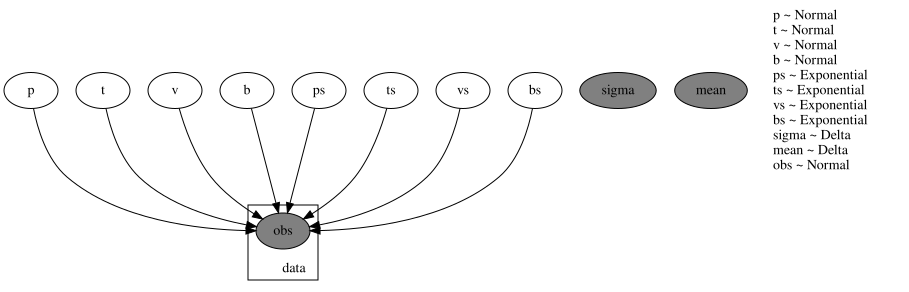

In [13]:
# define the probabilistic model using pyro (https://pyro.ai/)
# p, t, v, b are the coefficients
# for proximity, trace, visibility, and the intercept

# ps, ts, vs, bs are analogous coefficients,
# but they contribute to the variance,
# which is not assumed to remain fixed


def model_sigmavar(proximity, trace, visibility, how_far_score):
    p = pyro.sample("p", dist.Normal(0, 0.2))
    t = pyro.sample("t", dist.Normal(0, 0.2))
    v = pyro.sample("v", dist.Normal(0, 0.2))
    b = pyro.sample("b", dist.Normal(0.5, 0.3))

    ps = pyro.sample("ps", dist.Exponential(7))
    ts = pyro.sample("ts", dist.Exponential(7))
    vs = pyro.sample("vs", dist.Exponential(7))
    bs = pyro.sample("bs", dist.Exponential(7))

    sigma = pyro.deterministic(
        "sigma", bs + ps * proximity + ts * trace + vs * visibility
    )
    mean = pyro.deterministic("mean", b + p * proximity + t * trace + v * visibility)

    with pyro.plate("data", len(how_far_score)):
        pyro.sample("obs", dist.Normal(mean, sigma), obs=how_far_score)


pyro.render_model(
    model_sigmavar,
    model_args=(proximity, trace, visibility, how_far_score),
    render_distributions=True,
)

In [14]:
# helper functions for inference, showing results


def summary(samples, sites):
    site_stats = {}
    for site_name, values in samples.items():
        if site_name in sites:
            marginal_site = pd.DataFrame(values)
            describe = marginal_site.describe(
                percentiles=[0.05, 0.25, 0.5, 0.75, 0.95]
            ).transpose()
            site_stats[site_name] = describe[
                ["mean", "std", "5%", "25%", "50%", "75%", "95%"]
            ]
    return site_stats


def get_samples(
    proximity,
    trace,
    visibility,
    how_far_score,
    model=model_sigmavar,
    num_svi_iters=num_svi_iters,
    num_samples=num_samples,
):
    guide = AutoMultivariateNormal(model, init_loc_fn=init_to_mean)
    svi = SVI(model_sigmavar, guide, optim.Adam({"lr": 0.01}), loss=Trace_ELBO())

    iterations = []
    losses = []

    logging.info(f"Starting SVI inference with {num_svi_iters} iterations.")
    start_time = time.time()
    pyro.clear_param_store()
    for i in range(num_svi_iters):
        elbo = svi.step(proximity, trace, visibility, how_far_score)
        iterations.append(i)
        losses.append(elbo)
        if i % 200 == 0:
            logging.info("Elbo loss: {}".format(elbo))
    end_time = time.time()
    elapsed_time = end_time - start_time
    logging.info("SVI inference completed in %.2f seconds.", elapsed_time)

    if not smoke_test:
        fig = px.line(
            x=iterations, y=losses, title="ELBO loss", template="presentation"
        )
        labels = {"iterations": "iteration", "losses": "loss"}
        fig.update_xaxes(showgrid=False, title_text=labels["iterations"])
        fig.update_yaxes(showgrid=False, title_text=labels["losses"])
        fig.update_layout(width=700)
        fig.show()

    predictive = Predictive(
        model, guide=guide, num_samples=num_samples, return_sites=["t", "p", "v"]
    )
    rhf_svi = {
        k: v.flatten().reshape(num_samples, -1).detach().cpu().numpy()
        for k, v in predictive(proximity, trace, visibility, how_far_score).items()
        if k != "obs"
    }

    print("SVI-based coefficient marginals:")
    for site, values in summary(rhf_svi, ["t", "p", "v"]).items():
        print("Site: {}".format(site))
        print(values, "\n")

    return {"svi_samples": rhf_svi, "svi_guide": guide, "svi_predictive": predictive}


def calculate_R_squared(guide):
    predictive = pyro.infer.Predictive(model_sigmavar, guide=guide, num_samples=1000)
    predictions = predictive(proximity, trace, visibility, how_far_score)

    simulated_outcome = (
        predictions["b"]
        + predictions["p"] * proximity
        + predictions["t"] * trace
        + predictions["v"] * visibility
    )

    mean_sim_outcome = simulated_outcome.mean(0).detach().cpu().numpy()

    observed_mean = torch.mean(how_far_score)

    tss = torch.sum((how_far_score - observed_mean) ** 2)
    rss = torch.sum((how_far_score - mean_sim_outcome) ** 2)

    r_squared = 1 - (rss / tss)

    return r_squared.float().item()

In [15]:
samples_random = get_samples(proximity, trace, visibility, how_far_score)

2024-05-29 08:19:41,728 - Starting SVI inference with 1000 iterations.
2024-05-29 08:19:42,453 - Elbo loss: 4485.777056097984
2024-05-29 08:19:46,071 - Elbo loss: -18625.867947220802
2024-05-29 08:19:48,716 - Elbo loss: -21501.696821570396
2024-05-29 08:19:52,205 - Elbo loss: -21411.562371492386
2024-05-29 08:19:55,733 - Elbo loss: -23223.804137468338
2024-05-29 08:19:57,639 - SVI inference completed in 15.91 seconds.


SVI-based coefficient marginals:
Site: p
       mean       std        5%       25%       50%       75%       95%
0  0.005288  0.036352 -0.052094 -0.020617  0.005226  0.028384  0.068483 

Site: t
       mean       std        5%       25%       50%       75%       95%
0 -0.034748  0.046694 -0.109957 -0.066881 -0.035094 -0.003433  0.044832 

Site: v
       mean       std        5%       25%       50%       75%       95%
0  0.404614  0.027104  0.360384  0.386442  0.405431  0.422274  0.449412 



In [16]:
# plot the inferred posterior distributions of the coefficients
# Note that the model infers that the random foragers have
# near-zero coefficients for food trace and proximity score.
# The non-zero coefficient for visibility is consistent with the
# fact that the random foragers are mostly likely to move to nearby
# locations (higher visibility score) compared to farther locations.
ft.plot_coefs(
    samples_random, "Random foragers", nbins=120, ann_start_y=160, ann_break_y=50
)

/home/rafal/miniconda3/envs/collab/lib/python3.10/site-packages/plotly/express/_core.py:2065: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.



In [17]:
print("R squared:", calculate_R_squared(samples_random["svi_guide"]))

R squared: 0.4230942130088806


## Hungry birds

Moving on from random agents, we'll simulate agents that move toward food. We'll use more frames,and a larger gridworld environment. The simulation might take a bit longer.

In [18]:
random.seed(23)
np.random.seed(23)

hungry_sim = rhf.Foragers(
    grid_size=60, num_foragers=3, num_frames=num_frames, num_rewards=60, grab_range=3
)

hungry_sim()

hungry_sim = rhf.add_hungry_foragers(
    hungry_sim, num_hungry_foragers=3, rewards_decay=0.3, visibility_range=6
)

2024-05-29 08:20:21,768 - Generating frame 10/50 
2024-05-29 08:20:35,984 - Generating frame 20/50 
2024-05-29 08:20:47,396 - Generating frame 30/50 
2024-05-29 08:20:56,112 - Generating frame 40/50 


In [19]:
ft.animate_foragers(
    hungry_sim,
    plot_rewards=True,
    width=600,
    height=600,
    point_size=10,
    plot_traces=False,
)

In [20]:
# adding derived predictors
hungry_sim_derived = ft.derive_predictors(hungry_sim, dropna=False)

# if export is needed
# hungry_sim_derived.derivedDF.to_csv("foragers2.csv", index=False)

# plot with trace
# bird 2 again
ft.animate_foragers(
    hungry_sim_derived,
    plot_rewards=True,
    width=600,
    height=600,
    point_size=10,
    plot_traces=True,
    trace_multiplier=7,
)

2024-05-29 08:21:03,531 - traces done
2024-05-29 08:21:03,777 - visibility done
/home/rafal/s78projects/collaborative-intelligence/collab/foraging/toolkit/proximity.py:86: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.



/home/rafal/s78projects/collaborative-intelligence/collab/foraging/toolkit/proximity.py:86: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the int

In [21]:
# now plot proximity
ft.animate_foragers(
    hungry_sim_derived,
    plot_rewards=True,
    width=600,
    height=600,
    point_size=10,
    plot_proximity=1,
)

In [22]:
proximity, trace, visibility, how_far_score = prep_data_for_inference(
    hungry_sim_derived
)

41139 data points prepared for inference, dropped 841 rows with missing values.


In [40]:
# plot how_far_score as a function of proximity and food trace scores
# notice how all the points with high food trace scores
# have how_far_score close to 1,
# while how_far_score does not seem to systematically
# vary with proximity score

ft.visualise_forager_predictors(
    outcome=how_far_score,
    predictors=[proximity, trace],
    predictor_names=["proximity", "trace"],
    outcome_name="how_far_scaled",
)
# trace, proximity, how_far_score)

In [24]:
# run inference (SVI), and collect samples from the posterior
samples_hungry = get_samples(proximity, trace, visibility, how_far_score)

2024-05-29 08:21:06,169 - Starting SVI inference with 1000 iterations.
2024-05-29 08:21:06,188 - Elbo loss: 8541.545275568962
2024-05-29 08:21:09,570 - Elbo loss: -8921.340149700642
2024-05-29 08:21:12,810 - Elbo loss: -11701.639459013939
2024-05-29 08:21:14,625 - Elbo loss: -12347.863904953003
2024-05-29 08:21:16,319 - Elbo loss: -12056.834920108318
2024-05-29 08:21:17,947 - SVI inference completed in 11.78 seconds.


SVI-based coefficient marginals:
Site: p
       mean       std        5%       25%       50%       75%       95%
0 -0.005003  0.038613 -0.070056 -0.031079 -0.005157  0.021608  0.058169 

Site: t
       mean       std        5%       25%       50%       75%       95%
0  2.218101  0.096136  2.060396  2.153165  2.221374  2.281971  2.383977 

Site: v
       mean       std        5%       25%       50%       75%       95%
0  0.403986  0.025387  0.361999  0.386741  0.403435  0.420441  0.447894 



In [25]:
# plot the sampled posterior distributions of the coefficients
# Note that t, the coefficient for the food trace score, is high for hungry agents
ft.plot_coefs(
    samples_hungry, "Hungry foragers", nbins=160, ann_start_y=160, ann_break_y=10
)

/home/rafal/miniconda3/envs/collab/lib/python3.10/site-packages/plotly/express/_core.py:2065: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.



In [26]:
print("R squared:", calculate_R_squared(samples_hungry["svi_guide"]))

R squared: 0.3363018035888672


## Follower birds
Next, we'll simulate agents that don't care about food locations, but instead move to approach other agents, and we'll test that the model is able to correctly infer that these agents care about proximity to other agents, but not food.

In [27]:
random.seed(23)
np.random.seed(23)


follower_sim = rhf.Foragers(
    grid_size=60, num_foragers=3, num_frames=num_frames, num_rewards=30, grab_range=3
)
follower_sim()

follower_sim = rhf.add_follower_foragers(
    follower_sim,
    num_follower_foragers=3,
    visibility_range=6,
    getting_worse=0.5,
    optimal=3,
)

follower_sim_derived = ft.derive_predictors(
    follower_sim, getting_worse=0.5, optimal=3, visibility_range=6, dropna=False
)

# if export is needed
# follower_sim_derived.derivedDF.to_csv("foragers3.csv", index=False)

/home/rafal/s78projects/collaborative-intelligence/collab/foraging/toolkit/proximity.py:86: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.



/home/rafal/s78projects/collaborative-intelligence/collab/foraging/toolkit/proximity.py:86: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For e

In [28]:
ft.animate_foragers(
    follower_sim_derived,
    plot_rewards=True,
    width=600,
    height=600,
    point_size=10,
    plot_proximity=2,
)

In [29]:
proximity, trace, visibility, how_far_score = prep_data_for_inference(
    follower_sim_derived
)

16611 data points prepared for inference, dropped 339 rows with missing values.


In [38]:
# plot how_far_score as a function of the derived predictor scores (food trace and proximity score)
# Observe that the how_far_score is high when the proximity score is high, but doesn't appear to vary systematically with the food trace score
ft.visualise_forager_predictors(
    outcome=how_far_score,
    predictors=[proximity, trace],
    predictor_names=["proximity", "trace"],
    outcome_name="how_far_scaled",
)

In [31]:
# run inference (SVI), and collect samples from the posterior
samples_followers = get_samples(proximity, trace, visibility, how_far_score)

2024-05-29 08:21:27,257 - Starting SVI inference with 1000 iterations.
2024-05-29 08:21:27,298 - Elbo loss: 2491.7593237161636
2024-05-29 08:21:30,445 - Elbo loss: -4889.260266304016
2024-05-29 08:21:33,602 - Elbo loss: -6269.980973243713
2024-05-29 08:21:35,403 - Elbo loss: -6368.505734443665
2024-05-29 08:21:36,954 - Elbo loss: -6723.659967660904
2024-05-29 08:21:38,465 - SVI inference completed in 11.21 seconds.


SVI-based coefficient marginals:
Site: p
       mean       std        5%       25%       50%       75%       95%
0  0.347389  0.034048  0.292419  0.324113  0.346649  0.370418  0.401709 

Site: t
       mean       std        5%      25%      50%       75%       95%
0 -0.264526  0.048424 -0.339225 -0.29792 -0.26561 -0.232868 -0.180864 

Site: v
      mean       std        5%       25%      50%       75%       95%
0  0.16745  0.028085  0.120439  0.149142  0.16804  0.186352  0.212939 



In [32]:
# plot the sampled posterior distributions of the coefficients
# Note that p, the coefficient for the proximity score, is high for follower agents
ft.plot_coefs(
    samples_followers, "Follower foragers", nbins=140, ann_start_y=160, ann_break_y=10
)

/home/rafal/miniconda3/envs/collab/lib/python3.10/site-packages/plotly/express/_core.py:2065: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.



In [33]:
print("R squared:", calculate_R_squared(samples_followers["svi_guide"]))

R squared: 0.23977714776992798


In [34]:
def plot_all_coefficients(
    svi_samples, groups, title, xrange, yrange, generate_object=False
):
    data = {"p": [], "t": [], "inference_method": [], "group": []}

    for i, svi_sample in enumerate(svi_samples):
        site_p_svi = svi_sample["p"].flatten().tolist()
        site_t_svi = svi_sample["t"].flatten().tolist()
        data["p"] += site_p_svi
        data["t"] += site_t_svi
        data["inference_method"] += ["svi"] * len(site_p_svi)
        data["group"] += [groups[i]] * len(site_p_svi)

    df = pd.DataFrame(data)

    fig = px.scatter(
        df, x="p", y="t", color="group", title=title, template="presentation"
    )

    fig.update_xaxes(range=[xrange[0], xrange[1]], showgrid=False)
    fig.update_yaxes(range=[yrange[0], yrange[1]], showgrid=False)

    fig.update_layout(autosize=False, width=600, height=600)

    fig.update_traces(marker=dict(size=12, opacity=0.1))

    if generate_object:
        return fig
    else:
        fig.show()

In [39]:
# plot the inferred coefficients for all three bird types in one scatter plot
# Note that the coefficients for the food trace score (t) are high for hungry agents
# while the coefficients for the proximity score (p) are high for follower agents
# and the random agents have near-zero coefficients for both predictors
svi_samples = [
    samples_random["svi_samples"],
    samples_hungry["svi_samples"],
    samples_followers["svi_samples"],
]

groups = ["random", "hungry", "follower"]

fig2_rhf = plot_all_coefficients(
    svi_samples,
    groups,
    "Coefficients for three bird types",
    [-0.2, 0.5],
    [-1, 2.6],
    generate_object=True,
)

fig2_rhf.update_layout(legend=dict(yanchor="top", y=1.05, xanchor="right", x=0.97))

fig2_rhf.show()

/home/rafal/miniconda3/envs/collab/lib/python3.10/site-packages/plotly/express/_core.py:2065: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.



In [36]:
# this exports fig2_rfh

# pio.write_image(
#     fig2_rhf,
#     os.path.join(root, "docs/figures/fig2_rfh.png"),
#     engine="kaleido",
#     width=600,
#     height=600,
#     scale=5,
# )

In [37]:
notebook_ends = time.time()
print(
    "notebook took",
    notebook_ends - notebook_starts,
    "seconds, that is ",
    (notebook_ends - notebook_starts) / 60,
    "minutes to run",
)

notebook took 130.73457622528076 seconds, that is  2.1789096037546796 minutes to run
